# Libraries

In [29]:
import warnings
warnings.filterwarnings('ignore') 

import pandas as pd 
import numpy as np 
from wordcloud import WordCloud
import string
import matplotlib.pyplot as plt 
import seaborn as sns  
import plotly.express as px
from tqdm.auto import tqdm  

import nltk
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords 
from nltk.stem import WordNetLemmatizer 
from collections import Counter 
from string import punctuation 

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import LabelEncoder 
from sklearn.metrics import precision_score, recall_score , f1_score, accuracy_score,confusion_matrix 

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

from gensim.models import Word2Vec

import tensorflow as tf 
from tensorflow import keras 
from tensorflow.keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import Sequential 
from tensorflow.keras.metrics import Precision, Recall
from tensorflow.keras.layers import Dense , Embedding , Bidirectional , LSTM , Dropout
from tensorflow.keras.optimizers import Adam

lemma = WordNetLemmatizer()
lb = LabelEncoder()

# Data

In [30]:
data = pd.read_csv('dataset.csv')
data

,Text,Language,Label
0,@Charlie_Corley @Kristine1G @amyklobuchar @Sty...,en,litigious
1,#BadBunny: Como dos gotas de agua: Joven se di...,es,negative
2,https://t.co/YJNiO0p1JV Flagstar Bank disclose...,en,litigious
3,Rwanda is set to host the headquarters of Unit...,en,positive
4,OOPS. I typed her name incorrectly (today’s br...,en,litigious
...,...,...,...
937849,@Juice_Lemons in the dark. it’s so good,en,positive
937850,8.SSR &amp; Disha Salian case should be solved...,en,negative
937851,*ACCIDENT: Damage Only* - Raleigh Fire Depart...,en,negative
937852,@reblavoie So happy for her! She’s been incred...,en,positive


In [ ]:
data = data[~(data['Text'] < 5) & ~(data['Text'] > 60)]

In [31]:
data.columns

Index(['Text', 'Language', 'Label'], dtype='object')

In [32]:
data.drop(columns=['Language'], inplace = True)

In [33]:
data['Label'].value_counts()
data['tweet_len'] = [len(text.split()) for text in data.Text] 

## Data Cleaning

In [34]:
def cleaning(txt) : 
    txt = txt.lower() 
    
    txt = re.sub("<br /><br />" , " " , txt) # replace line breaks
    
    txt = re.sub(r"(.)\1\1+" , r"\1\1" , txt)  # Replace 3 or more consecutive letters by 2 letter
    
    # replace all emojis
    txt = re.sub(r'<3', '<heart>' , txt) 
    txt = re.sub(r"[8:=;]['`\-]?[)d]+" , '<smile>' , txt)
    txt = re.sub(r"[8:=;]['`\-]?\(+" , '<sadface>' , txt) 
    txt = re.sub(r"[8:=;]['`\-]?[\/|l*]" , '<neutralface>' , txt) 
    txt = re.sub(r"[8:=;]['`\-]?p+" , '<lolface>' , txt)
    
    txt = re.sub(r"[^a-z0-9<>]" , ' ' , txt) # # Remove non-alphanumeric and symbols
    
    # Adding space on either side of '/' to seperate words (After replacing URLS). 
    txt = re.sub(r'/' , ' / ' , txt)
    
    txt = re.sub('<.*?>', '', txt) # HTML tags
    txt = re.sub(r'\d+', '', txt) # numbers
    txt = re.sub(r'[^\w\s]', '', txt) # special characters
    txt = re.sub(r'http\S+', '', txt) # URLs or web links
    txt = re.sub(r'@\S+', '', txt) # mentions
    txt = re.sub(r'#\S+', '', txt) # hashtags
    
    return txt

In [35]:
data['Text'] = data['Text'].apply(cleaning)
print(f'Total number of samples: {len(data)}')
data.drop_duplicates(inplace = True)
data.dropna(inplace = True)
print(f'Total number of samples after removal: {len(data)}')

Total number of samples: 937854
Total number of samples after removal: 930041


# EDA

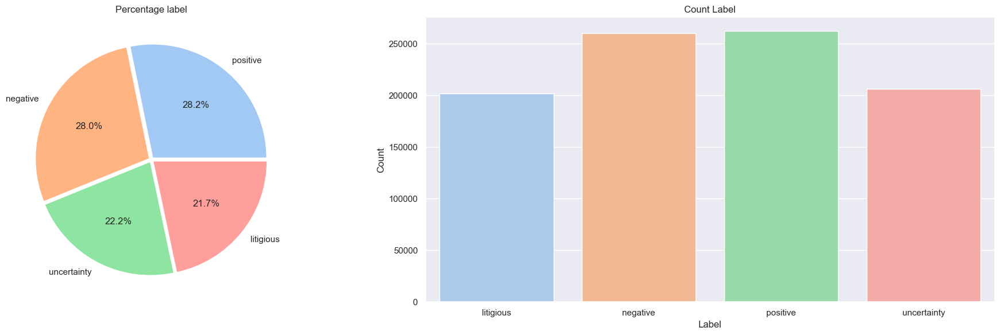

In [36]:
label_count = data['Label'].value_counts()
fig, ax = plt.subplots(1, 2, figsize = (20, 6))

sns.set_theme(style = 'darkgrid', palette='pastel')
color = sns.color_palette(palette='pastel')
explode = [0.02] * len(label_count)

ax[0].pie(label_count.values, labels = label_count.index, autopct = '%1.1f%%', colors = color, explode = explode) 
ax[0].set_title('Percentage label')

sns.countplot(x = data['Label'], ax = ax[1], palette='pastel')
ax[1].set_title('Count Label')
ax[1].set_xlabel('Label')
ax[1].set_ylabel('Count')
plt.tight_layout()
plt.show()

In [37]:
px.histogram(data, x = 'tweet_len', height = 700, title = 'Tweets Length Distribution', marginal = 'box')

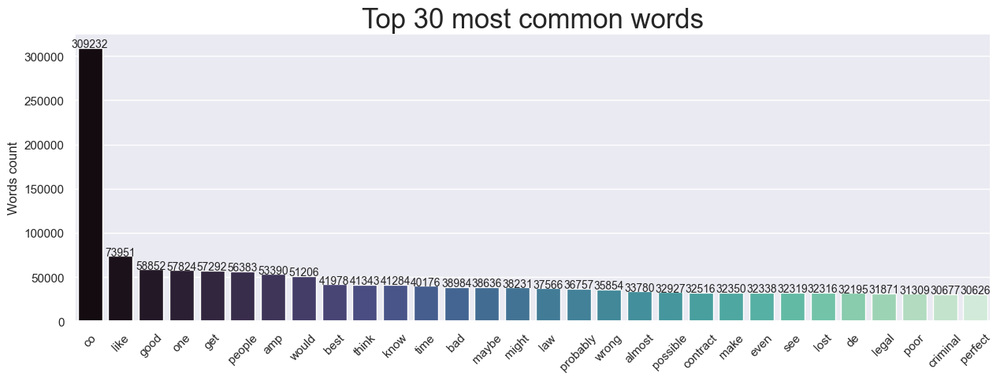

In [38]:
def most_used_words(n_words):
    text = ''.join(data['Text'].values)
    
    words = text.split()
    
    #Remove punctuation
    punc = list(punctuation)
    words = [word for word in words if word not in punctuation]
    
    #Remove stopwords
    stop_words = set(stopwords.words('english'))
    words = [word for word in words if word not in stop_words]
    
    word_count = Counter(words)
    
    top_words = word_count.most_common(n_words)
    
    return top_words

top_words = most_used_words(30)
xaxis = [word[0] for word in top_words]
yaxis = [word[1] for word in top_words]

plt.figure(figsize=(15,5))
ax = sns.barplot(x=xaxis, y=yaxis, palette='mako')
plt.title('Top 30 most common words', size = 25)

#Adding value on top of each bar
for i, count in enumerate(yaxis):
    plt.text(i, count + 500, str(count), ha='center', fontsize=10)


plt.ylabel('Words count')
plt.xticks(rotation = 45)
plt.subplots_adjust(bottom = 0.15)
plt.show()

# Data Preprocessing

## Encoding

In [39]:
labels = lb.fit_transform(data['Label'].values)
np.unique(labels)

array([0, 1, 2, 3])

## Text Preprocessing

In [40]:
def process_text(text):
    # Initialize tools    
    LEMMATIZER = WordNetLemmatizer()
    STOP_WORDS = stopwords.words('english')
    PUNCTUATION = string.punctuation

    
    # Tokenization, stopword removal, stemming, and lemmatization
    words = word_tokenize(text)
    words = [word for word in words if word not in PUNCTUATION and word not in STOP_WORDS and word.isalpha()]
    words = [LEMMATIZER.lemmatize(word) for word in words]
    
    return ' '.join(words)
data['Text'] = data['Text'].apply(process_text)
data

,Text,Label,tweet_len
0,charlie corley kristineg amyklobuchar stylewri...,litigious,22
1,badbunny como do gotas de agua joven se disfra...,negative,19
2,co yjniopjv flagstar bank discloses data breac...,litigious,13
3,rwanda set host headquarters united nation dev...,positive,25
4,oops typed name incorrectly today brave witnes...,litigious,27
...,...,...,...
937849,juice lemon dark good,positive,7
937850,ssr amp disha salian case solved amp drug cart...,negative,47
937851,accident damage raleigh fire department fairwa...,negative,11
937852,reblavoie happy incredible,positive,8


## WordCloud

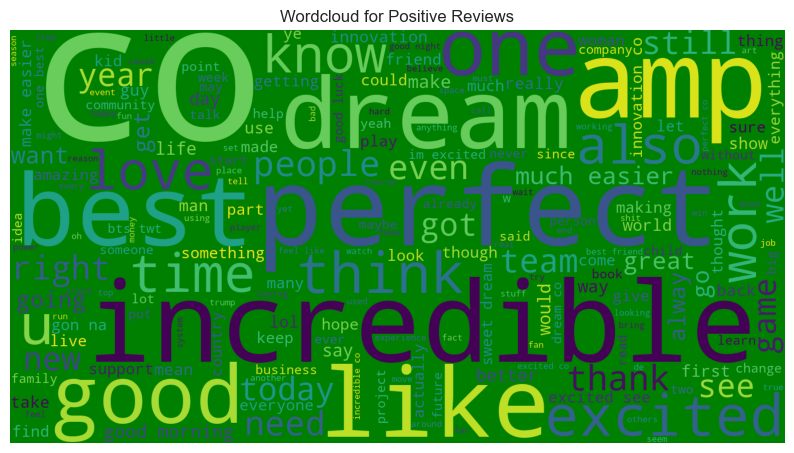

In [41]:
positive_reviews = data[data['Label'] == 'positive']['Text']
pos = ' '.join(map(str, positive_reviews))
pos_wordcloud = WordCloud(width=1500, height=800,
                          background_color='green',
                          stopwords=stopwords.words('english'),
                          min_font_size = 15).generate(pos)
plt.figure(figsize = (10, 10))
plt.imshow(pos_wordcloud)
plt.title('Wordcloud for Positive Reviews')
plt.axis('off')
plt.show()

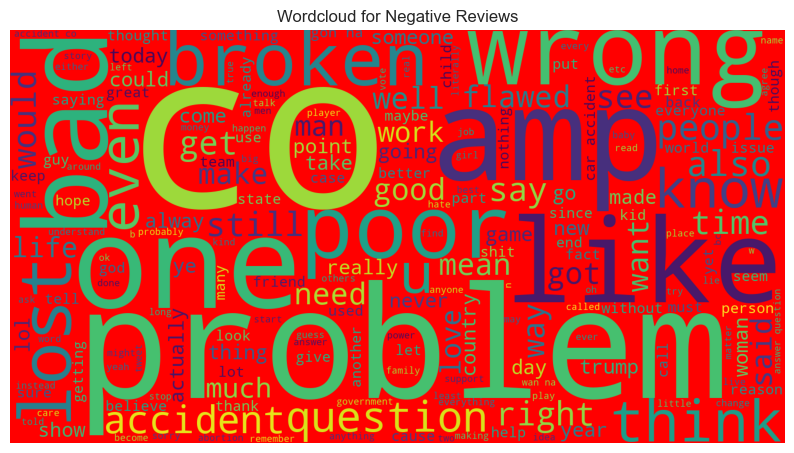

In [42]:
positive_reviews = data[data['Label'] == 'negative']['Text']
pos = ' '.join(map(str, positive_reviews))
pos_wordcloud = WordCloud(width=1500, height=800,
                          background_color='red',
                          stopwords=stopwords.words('english'),
                          min_font_size = 15).generate(pos)
plt.figure(figsize = (10, 10))
plt.imshow(pos_wordcloud)
plt.title('Wordcloud for Negative Reviews')
plt.axis('off')
plt.show()

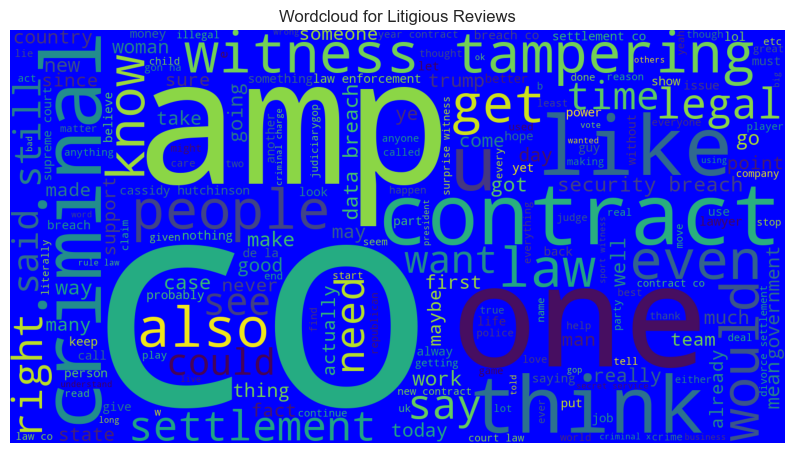

In [43]:
positive_reviews = data[data['Label'] == 'litigious']['Text']
pos = ' '.join(map(str, positive_reviews))
pos_wordcloud = WordCloud(width=1500, height=800,
                          background_color='blue',
                          stopwords=stopwords.words('english'),
                          min_font_size = 15).generate(pos)
plt.figure(figsize = (10, 10))
plt.imshow(pos_wordcloud)
plt.title('Wordcloud for Litigious Reviews')
plt.axis('off')
plt.show()

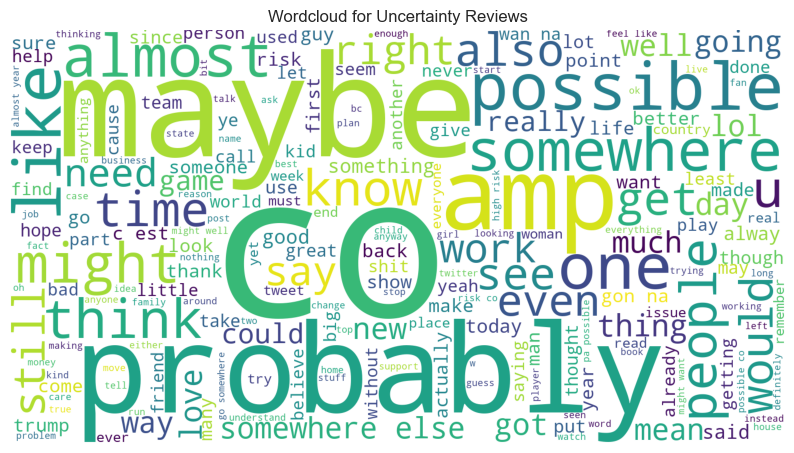

In [44]:
positive_reviews = data[data['Label'] == 'uncertainty']['Text']
pos = ' '.join(map(str, positive_reviews))
pos_wordcloud = WordCloud(width=1500, height=800,
                          background_color='white',
                          stopwords=stopwords.words('english'),
                          min_font_size = 15).generate(pos)
plt.figure(figsize = (10, 10))
plt.imshow(pos_wordcloud)
plt.title('Wordcloud for Uncertainty Reviews')
plt.axis('off')
plt.show()

## Feature Extraction

In [45]:
vec = TfidfVectorizer(strip_accents='ascii', analyzer = 'word',
                      smooth_idf=True, norm = None, min_df=10)
vec.fit(data['Text'])
print(f'No of feature words: ', len(vec.get_feature_names_out()))

No of feature words:  53874


In [46]:
Features = vec.fit_transform(data['Text']).toarray()

MemoryError: Unable to allocate 373. GiB for an array with shape (930041, 53874) and data type float64

In [ ]:
print('The shape of the dataset: ', Features.shape)